# Hate Speech and Toxic Comment Detection

**Name: Anjali Haryani**

**Date: 09 December 2024**


# Data Cleaning and Visualization

In [1]:
# Importing the libraries
import pandas as pd

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px

import re
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/gauravnathani/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [2]:
# Loading the dataset
path='/Users/gauravnathani/Downloads/archive (6)/'

In [3]:
# Loading test and train data
train=pd.read_csv(path+"train.csv")
test=pd.read_csv(path+"test.csv")

In [4]:
# Top 10 rows of train dataset
train.head(10)

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0
5,00025465d4725e87,"""\n\nCongratulations from me as well, use the ...",0,0,0,0,0,0
6,0002bcb3da6cb337,COCKSUCKER BEFORE YOU PISS AROUND ON MY WORK,1,1,1,0,1,0
7,00031b1e95af7921,Your vandalism to the Matt Shirvington article...,0,0,0,0,0,0
8,00037261f536c51d,Sorry if the word 'nonsense' was offensive to ...,0,0,0,0,0,0
9,00040093b2687caa,alignment on this subject and which are contra...,0,0,0,0,0,0


In [5]:
# Top 5 rows of test dataset
test.head()

,id,comment_text
0,00001cee341fdb12,Yo bitch Ja Rule is more succesful then you'll...
1,0000247867823ef7,== From RfC == \n\n The title is fine as it is...
2,00013b17ad220c46,""" \n\n == Sources == \n\n * Zawe Ashton on Lap..."
3,00017563c3f7919a,":If you have a look back at the source, the in..."
4,00017695ad8997eb,I don't anonymously edit articles at all.


In [6]:
# Number of rows in train dataset
print("No. of rows:", train.shape[0])

No. of rows: 159571


In [7]:
# Number of rows in test dataset
print("No. of rows:", test.shape[0])

No. of rows: 153164


In [8]:
# Number of values as yes in hate tag columns

hate_tag_count=train.iloc[:,2:].sum()
hate_tag_count

toxic            15294
severe_toxic      1595
obscene           8449
threat             478
insult            7877
identity_hate     1405
dtype: int64

In [9]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 159571 entries, 0 to 159570
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   id             159571 non-null  object
 1   comment_text   159571 non-null  object
 2   toxic          159571 non-null  int64 
 3   severe_toxic   159571 non-null  int64 
 4   obscene        159571 non-null  int64 
 5   threat         159571 non-null  int64 
 6   insult         159571 non-null  int64 
 7   identity_hate  159571 non-null  int64 
dtypes: int64(6), object(2)
memory usage: 9.7+ MB


In [10]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 153164 entries, 0 to 153163
Data columns (total 2 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   id            153164 non-null  object
 1   comment_text  153164 non-null  object
dtypes: object(2)
memory usage: 2.3+ MB


In [11]:

fig = px.pie(values=hate_tag_count.values, names=hate_tag_count.index, 
             title="Hate Tag Distribution", hole=0.3)
fig.update_traces(textinfo='percent+label')  # Show percentage and label

fig.show()


In [12]:

fig = px.bar(x=hate_tag_count.index, y=hate_tag_count.values, 
             title="Class Imbalance Visualization", 
             labels={'x': 'Tag Type', 'y': 'Number of Tags'})

fig.update_layout(xaxis_title="Tag Type", yaxis_title="Number of Tags")
fig.show()


For the pie chart and bar chart, we plotted the relative distribution of hate tags in the dataset and observed a substantial class imbalance. "Toxic" tags had the highest frequency, while "threat" tags were the least common.

In [13]:
#Add an additional column for clean comments
train['clean']=(train.iloc[:,2:].sum(axis=1)==0).astype(int)

In [14]:
train.head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate,clean
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0,1
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0,1
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0,1
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0,1
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0,1


In [15]:
count_tag=train.iloc[:,2:].sum()
count_tag

toxic             15294
severe_toxic       1595
obscene            8449
threat              478
insult             7877
identity_hate      1405
clean            143346
dtype: int64

In [16]:
print("Total comments = ",len(train))
print("Total clean comments = ",train['clean'].sum())
print("Total hate tags =",hate_tag_count.sum())
print("Total hate comments =",len(train)-train['clean'].sum())

Total comments =  159571
Total clean comments =  143346
Total hate tags = 35098
Total hate comments = 16225


In [17]:
#Check for missing values in Train dataset
missing_values =train.isnull().sum()
print('No. of null values =', missing_values)

No. of null values = id               0
comment_text     0
toxic            0
severe_toxic     0
obscene          0
threat           0
insult           0
identity_hate    0
clean            0
dtype: int64


There are no missing values in dataset

In [18]:
import plotly.express as px

# Assuming 'train' is the DataFrame with the 'clean' column
clean_counts = train['clean'].value_counts()

# Plotly bar chart for 'clean' and 'non-clean' counts
fig = px.bar(x=clean_counts.index, y=clean_counts.values,
             title="Clean vs. Non-Clean Rows",
             labels={'x': 'Clean (1 = Clean, 0 = Not Clean)', 'y': 'Number of Rows'})

fig.update_layout(xaxis_title="Clean Status", yaxis_title="Row Count")
fig.show()


For the bar graph, we added a new column for "clean" tags and then plotted the data. This revealed that a significant portion of the comments were clean.

In [19]:
#This code calculates how many tags each comment has in the train DataFrame.
multi_tag=train.iloc[:,2:].sum(axis=1).value_counts()
multi_tag

1    149706
3      4209
2      3480
4      1760
5       385
6        31
Name: count, dtype: int64

In [20]:
# multiple tag with the index as the number of tags and values as the count of comments
fig = px.bar(x=multi_tag.index, y=multi_tag.values, 
             title="Multi-Class Classification",
             labels={'x': 'Number of Tags', 'y': 'Number of Comments'})

fig.update_layout(xaxis_title="Number of Tags", yaxis_title="Number of Comments", width=700, height=500)
fig.show()


The bar plot indicates that most comments have only a single tag. However, there are also comments with as many as 4 or 5 hate tags.

In [21]:
# Calculate the correlation matrix
corr = train.iloc[:, 2:].corr()

# Create an interactive heatmap with Plotly
fig = px.imshow(corr, text_auto=True, color_continuous_scale="Viridis", 
                title="Correlation Heatmap")

# Display the interactive plot
fig.show()


The heatmap of tag correlations reveals a negative correlation between clean comments and toxic comments. Additionally, a strong positive correlation is evident between certain tags, such as toxic-obscene and toxic-insult.

In [22]:
print("identity_hate:")
print(train[train.identity_hate==1].iloc[27,1])

identity_hate:
Im sorry are you fucking stupid that nice person just gave me a warning then you fucking block me, nigger cunt eat pussy bitch


In [23]:
import re
df=train.copy()
df['count_sent']=df["comment_text"].apply(lambda x: len(re.findall("\n",str(x)))+1)
df['count_word']=df["comment_text"].apply(lambda x: len(str(x).split()))
df['count_unique_word']=df["comment_text"].apply(lambda x: len(set(str(x).split())))
df['count_letters']=df["comment_text"].apply(lambda x: len(str(x)))

In [24]:
df_counts=df[['count_sent','count_word','count_unique_word','count_letters']]


In [25]:
df_counts.describe()

,count_sent,count_word,count_unique_word,count_letters
count,159571.00000,159571.000000,159571.000000,159571.000000
mean,3.52074,67.273527,48.097323,394.073221
std,5.96225,99.230702,54.436443,590.720282
min,1.00000,1.000000,1.000000,6.000000
25%,1.00000,17.000000,16.000000,96.000000
50%,2.00000,36.000000,31.000000,205.000000
75%,3.00000,75.000000,59.000000,435.000000
max,313.00000,1411.000000,816.000000,5000.000000


In [26]:
# Loop through each numerical column in df_counts
for column in df_counts.select_dtypes(include=['number']).columns:
    fig = px.histogram(df_counts, x=column, nbins=50, title=f"Histogram of {column}")
    fig.update_layout(width=800, height=600)  # Set size for each plot
    fig.show()

from above plot we can see that many comments contain very few sentences, words, or letters.

In [27]:
df1 = df.copy()
df1['count_sent'] = df1['count_sent'].apply(lambda x: min(x, 7))

# Create a box plot in Plotly
fig = px.box(df1, y='count_sent', x='clean')
fig.update_layout(width=800, height=600)  # Adjust the size as needed
fig.show()


There is minimal correlation between the number of sentences and a comment's toxicity.


In [28]:

df1 = df.copy()
df1['count_word'] = df1['count_word'].apply(lambda x: min(x, 200))

# Create a box plot in Plotly
fig = px.box(df1, y='count_word', x='clean')
fig.update_layout(width=800, height=600)  # Adjust the size as needed
fig.show()


There is a slight correlation between word count and toxicity—comments with fewer words tend to have higher toxicity.

A quick review of the comments showed that many were spam. To identify spam comments, we classified those with a high number of repeated words and a low percentage of unique words as spam.

In [29]:


# Calculate the percentage of unique words
df['word_unique_percent'] = df['count_unique_word'] * 100 / df['count_word']

# Filter spammers with less than 25% unique words
spammers = df[df['word_unique_percent'] < 25]

# Sum the values of the selected columns for spammers
x = spammers.iloc[:, 2:9].sum()

# Create an interactive bar plot in Plotly
fig = px.bar(x=x.index, y=x.values, labels={'x': 'Categories', 'y': 'Sum'}, title="Spam Comments Toxicity Distribution")
fig.update_layout(width=800, height=600)  # Adjust the size as needed
fig.show()

From the above bar plot, it’s evident that spam comments (i.e., comments with a lower percentage of unique words) tend to have a higher likelihood of being toxic.

# Data Preprocessing

In [30]:
# Ensure stopwords and stemmer are available
stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()


# Define the cleaning function
def clean(comment):
    comment = comment.lower()
    comment = re.sub('[^a-zA-Z]', ' ', comment)  # Remove non-letter characters
    comment = comment.strip().split()
    comment = [stemmer.stem(word) for word in comment if word not in stop_words and len(word) < 30]
    return ' '.join(comment)

# Apply the clean function to the 'comment' column in the DataFrame
df['cleaned_comment'] = df['comment_text'].apply(clean)

In [31]:
print("Cleaned Comment:", df.loc[27, 'cleaned_comment'])
print("\n Original Comment Text:", df.loc[27, 'comment_text'])

Cleaned Comment: ye mother child case michael jackson studi motiv reason judg upon charact harshli wacko jacko tell ignor incrimin go continu refut bullshit jayjg keep throw jun utc

 Original Comment Text: Yes, because the mother of the child in the case against Michael Jackson was studied in here motives and reasonings and judged upon her character just as harshly as Wacko Jacko himself.  Don't tell me to ignore it and incriminate myself.  I am going to continue refuting the bullshit that Jayjg keeps throwing at me.   18:01, 16 Jun 2005 (UTC)


# Modeling

## LSTM Model

Epoch 1/2
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8740 - auc_17: 0.9126 - loss: 0.0975 - mean_squared_error: 0.0265
Epoch 1 - Train Accuracy: 0.9510, Validation Accuracy: 0.9939
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 263s 58ms/step - accuracy: 0.8740 - auc_17: 0.9126 - loss: 0.0975 - mean_squared_error: 0.0265 - val_accuracy: 0.9939 - val_auc_17: 0.9785 - val_loss: 0.0503 - val_mean_squared_error: 0.0141
Epoch 2/2
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.9912 - auc_17: 0.9847 - loss: 0.0455 - mean_squared_error: 0.0130
Epoch 2 - Train Accuracy: 0.9903, Validation Accuracy: 0.9929
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 256s 57ms/step - accuracy: 0.9912 - auc_17: 0.9847 - loss: 0.0455 - mean_squared_error: 0.0130 - val_accuracy: 0.9929 - val_auc_17: 0.9811 - val_loss: 0.0473 - val_mean_squared_error: 0.0134
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 62s 14ms/step
499/499 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step

Classification Report (Validation Set):
               precision    recall  

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in samples with no true labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 in samples with no true nor predicted la


Overall Train Accuracy: 0.9293
Overall Validation Accuracy: 0.9183


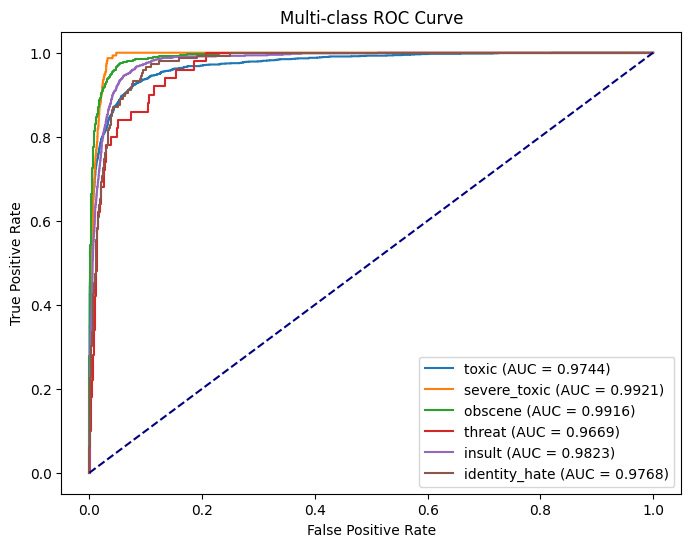

In [64]:
# Required Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras.layers import Dense, Input, LSTM, Embedding, Dropout, GlobalMaxPool1D
from keras.models import Model
from keras.callbacks import Callback
from keras import metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, roc_auc_score, roc_curve, accuracy_score
import re
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

# stopwords and stemmer
stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()

# Define the cleaning function
def clean(comment):
    comment = comment.lower()
    comment = re.sub('[^a-zA-Z]', ' ', comment)  
    comment = comment.strip().split()
    comment = [stemmer.stem(word) for word in comment if word not in stop_words and len(word) < 30]
    return ' '.join(comment)

# Path to the dataset
path = "/Users/gauravnathani/Desktop/NU Fall Semester 1/Machine Learning Project/"

# Load the data
train = pd.read_csv(path + "train.csv")
test = pd.read_csv(path + "test.csv")
labels = pd.read_csv(path + "test_labels.csv")

# Apply the clean function to preprocess comments
train['cleaned_comment'] = train['comment_text'].apply(clean)
test['cleaned_comment'] = test['comment_text'].apply(clean)

# Define target classes
classes = ["toxic", "severe_toxic", "obscene", "threat", "insult", "identity_hate"]
y = train[classes].values
list_sentences_train = train["cleaned_comment"]
list_sentences_test = test["cleaned_comment"]

# Tokenization
max_features = 20000
tokenizer = Tokenizer(num_words=max_features)
tokenizer.fit_on_texts(list_sentences_train)
list_tokenized_train = tokenizer.texts_to_sequences(list_sentences_train)
list_tokenized_test = tokenizer.texts_to_sequences(list_sentences_test)

# Padding
maxlen = 200
X_t = pad_sequences(list_tokenized_train, maxlen=maxlen)
X_te = pad_sequences(list_tokenized_test, maxlen=maxlen)

# Custom Callback to log train and validation metrics after each epoch
class MetricsLogger(Callback):
    def on_epoch_end(self, epoch, logs=None):
        train_accuracy = logs.get("accuracy")
        val_accuracy = logs.get("val_accuracy")
        print(f"\nEpoch {epoch + 1} - Train Accuracy: {train_accuracy:.4f}, Validation Accuracy: {val_accuracy:.4f}")

# LSTM Model
inp = Input(shape=(maxlen,))
embed_size = 128
x = Embedding(max_features, embed_size)(inp)
x = LSTM(60, return_sequences=True, name='lstm_layer')(x)
x = GlobalMaxPool1D()(x)
x = Dropout(0.1)(x)
x = Dense(50, activation="relu")(x)
x = Dropout(0.1)(x)
x = Dense(6, activation="sigmoid")(x)

# Compile Model
model = Model(inputs=inp, outputs=x)
model.compile(
    loss='binary_crossentropy',
    optimizer='adam',
    metrics=[
        'accuracy',  # Add accuracy to metrics
        metrics.MeanSquaredError(),
        metrics.AUC(),
    ]
)

# Train-Validation Split
X_train, X_val, y_train, y_val = train_test_split(X_t, y, test_size=0.1, random_state=1)

# Training the Model
batch_size = 32
epochs = 2
history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    batch_size=batch_size,
    epochs=epochs,
    callbacks=[MetricsLogger()]  # Include the custom callback
)

# Predictions
preds_train = model.predict(X_train)
preds_val = model.predict(X_val)

# Classification Report for Validation Set
print("\nClassification Report (Validation Set):")
print(classification_report(y_val, preds_val > 0.5, target_names=classes))

# Train and Validation ROC-AUC Score
train_auc = roc_auc_score(y_train, preds_train, average='macro')
val_auc = roc_auc_score(y_val, preds_val, average='macro')
print(f"\nTrain ROC-AUC Score: {train_auc:.4f}")
print(f"Validation ROC-AUC Score: {val_auc:.4f}")

# Overall Accuracy Calculation
train_accuracy = accuracy_score(y_train, preds_train > 0.5)
val_accuracy = accuracy_score(y_val, preds_val > 0.5)

# Print Overall Train and Validation Accuracy
print(f"\nOverall Train Accuracy: {train_accuracy:.4f}")
print(f"Overall Validation Accuracy: {val_accuracy:.4f}")

# ROC Curve for Multi-class classification
plt.figure(figsize=(8, 6))

# Iterate through each class and plot its ROC curve
for i, class_name in enumerate(classes):
    fpr, tpr, _ = roc_curve(y_val[:, i], preds_val[:, i])
    auc_score = roc_auc_score(y_val[:, i], preds_val[:, i])
    plt.plot(fpr, tpr, label=f'{class_name} (AUC = {auc_score:.4f})')

# Diagonal line for random classifier
plt.plot([0, 1], [0, 1], color="navy", linestyle="--")

plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Multi-class ROC Curve")
plt.legend(loc="lower right")
plt.show()


## LSTM with Glove Embedding

Epoch 1/2
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 177s 39ms/step - auc_4: 0.9142 - loss: 0.0970 - mean_squared_error: 0.0258
Epoch 2/2
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 176s 39ms/step - auc_4: 0.9721 - loss: 0.0579 - mean_squared_error: 0.0157
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 59s 13ms/step
499/499 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step

Classification Report (Validation Set):
               precision    recall  f1-score   support

        toxic       0.88      0.64      0.74      1568
 severe_toxic       0.80      0.18      0.29       155
      obscene       0.86      0.71      0.78       872
       threat       0.00      0.00      0.00        50
       insult       0.72      0.62      0.66       804
identity_hate       0.68      0.34      0.45       146

    micro avg       0.82      0.61      0.70      3595
    macro avg       0.66      0.41      0.49      3595
 weighted avg       0.81      0.61      0.69      3595
  samples avg       0.06      0.06      0.05      3595



/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in samples with no true labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 in samples with no true nor predicted la


Train ROC-AUC Score: 0.9771
Validation ROC-AUC Score: 0.9741

Overall Train Accuracy: 0.9201
Overall Validation Accuracy: 0.9162


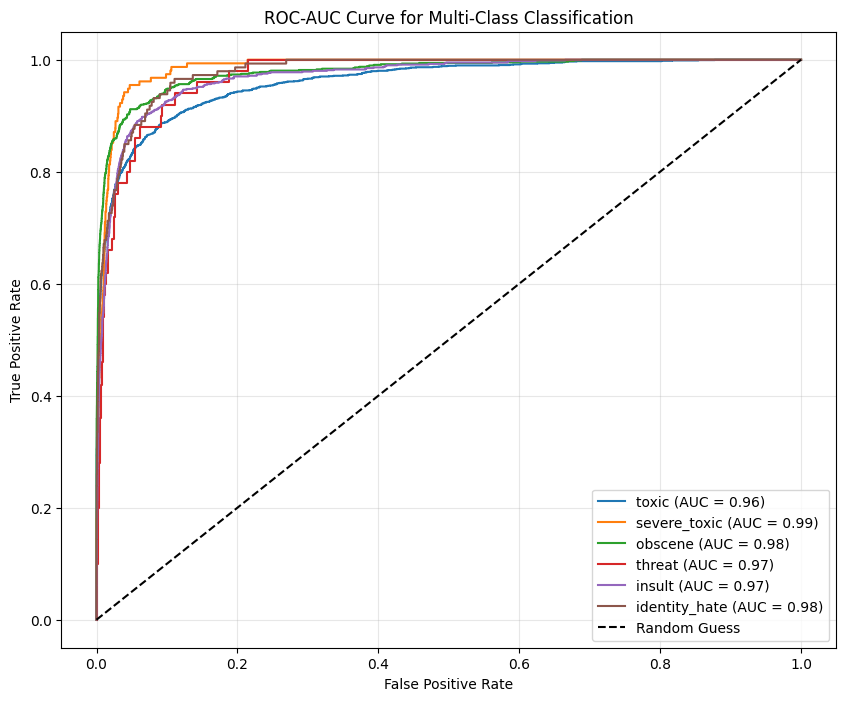

In [44]:
# Required Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras.layers import Dense, Input, LSTM, Embedding, Dropout, GlobalMaxPool1D
from keras.models import Model
from keras import metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, roc_auc_score, roc_curve, confusion_matrix, accuracy_score
import seaborn as sns
import re
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

#stopwords and stemmer
stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()

# Define the cleaning function
def clean(comment):
    comment = comment.lower()
    comment = re.sub('[^a-zA-Z]', ' ', comment)  # Remove non-letter characters
    comment = comment.strip().split()
    comment = [stemmer.stem(word) for word in comment if word not in stop_words and len(word) < 30]
    return ' '.join(comment)

# Path to the dataset
path = "/Users/gauravnathani/Desktop/NU Fall Semester 1/Machine Learning Project/"

# Load the data
train = pd.read_csv(path + "train.csv")
test = pd.read_csv(path + "test.csv")
labels = pd.read_csv(path + "test_labels.csv")

# Apply the clean function to preprocess comments
train['cleaned_comment'] = train['comment_text'].apply(clean)
test['cleaned_comment'] = test['comment_text'].apply(clean)

# Define target classes
classes = ["toxic", "severe_toxic", "obscene", "threat", "insult", "identity_hate"]
y = train[classes].values
list_sentences_train = train["cleaned_comment"]
list_sentences_test = test["cleaned_comment"]

# Tokenization
max_features = 20000
tokenizer = Tokenizer(num_words=max_features)
tokenizer.fit_on_texts(list_sentences_train)
list_tokenized_train = tokenizer.texts_to_sequences(list_sentences_train)
list_tokenized_test = tokenizer.texts_to_sequences(list_sentences_test)

# Padding
maxlen = 200
X_t = pad_sequences(list_tokenized_train, maxlen=maxlen)
X_te = pad_sequences(list_tokenized_test, maxlen=maxlen)

# Load Pre-trained GloVe Embeddings
embedding_file_path = "/Users/gauravnathani/Downloads/glove.6B.100d.txt"
embed_size = 100  # GloVe embedding dimension

# Create embedding index
embedding_index = {}
with open(embedding_file_path, "r", encoding="utf-8") as f:
    for line in f:
        values = line.split()
        word = values[0]
        vector = np.asarray(values[1:], dtype="float32")
        embedding_index[word] = vector

# Prepare embedding matrix
word_index = tokenizer.word_index
num_words = min(max_features, len(word_index) + 1)
embedding_matrix = np.zeros((num_words, embed_size))
for word, i in word_index.items():
    if i >= max_features:
        continue
    embedding_vector = embedding_index.get(word)
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector

# LSTM Model with Pre-trained Embeddings
inp = Input(shape=(maxlen,))
x = Embedding(num_words, embed_size, weights=[embedding_matrix], trainable=False)(inp)  # Use pre-trained embeddings
x = LSTM(60, return_sequences=True, name='lstm_layer')(x)
x = GlobalMaxPool1D()(x)
x = Dropout(0.1)(x)
x = Dense(50, activation="relu")(x)
x = Dropout(0.1)(x)
x = Dense(6, activation="sigmoid")(x)

# Compile Model
model = Model(inputs=inp, outputs=x)
model.compile(
    loss='binary_crossentropy',
    optimizer='adam',
    metrics=[
        metrics.MeanSquaredError(),
        metrics.AUC(),
    ]
)

# Train-Validation Split
X_train, X_val, y_train, y_val = train_test_split(X_t, y, test_size=0.1, random_state=1)

# Training the Model
batch_size = 32
epochs = 2
model.fit(X_train, y_train, batch_size=batch_size, epochs=epochs)

# Predictions
preds_train = model.predict(X_train)
preds_val = model.predict(X_val)

# Classification Report for Validation Set
print("\nClassification Report (Validation Set):")
print(classification_report(y_val, preds_val > 0.5, target_names=classes))

# Train and Validation ROC-AUC Score
train_auc = roc_auc_score(y_train, preds_train, average='macro')
val_auc = roc_auc_score(y_val, preds_val, average='macro')
print(f"\nTrain ROC-AUC Score: {train_auc:.4f}")
print(f"Validation ROC-AUC Score: {val_auc:.4f}")


# Overall Accuracy Calculation
train_accuracy = accuracy_score(y_train, preds_train > 0.5)
val_accuracy = accuracy_score(y_val, preds_val > 0.5)

# Print Overall Train and Validation Accuracy
print(f"\nOverall Train Accuracy: {train_accuracy:.4f}")
print(f"Overall Validation Accuracy: {val_accuracy:.4f}")

# Plot ROC Curve for Multi-Class Classification
plt.figure(figsize=(10, 8))

# Generate ROC-AUC curves for each class
for i, class_name in enumerate(classes):
    fpr, tpr, _ = roc_curve(y_val[:, i], preds_val[:, i])
    auc_score = roc_auc_score(y_val[:, i], preds_val[:, i])
    plt.plot(fpr, tpr, label=f"{class_name} (AUC = {auc_score:.2f})")

# Plot the random guess line
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")

# Customize the plot
plt.title("ROC-AUC Curve for Multi-Class Classification")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.grid(alpha=0.3)
plt.show()


## Bi-LSTM Model

Epoch 1/2
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 300s 67ms/step - auc_14: 0.8959 - loss: 0.0990 - mean_squared_error: 0.0259
Epoch 2/2
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 298s 66ms/step - auc_14: 0.9838 - loss: 0.0448 - mean_squared_error: 0.0126
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 62s 14ms/step
499/499 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step

Classification Report (Validation Set):
               precision    recall  f1-score   support

        toxic       0.84      0.74      0.79      1568
 severe_toxic       0.84      0.14      0.23       155
      obscene       0.86      0.81      0.83       872
       threat       0.00      0.00      0.00        50
       insult       0.74      0.66      0.70       804
identity_hate       0.00      0.00      0.00       146

    micro avg       0.82      0.67      0.74      3595
    macro avg       0.55      0.39      0.43      3595
 weighted avg       0.78      0.67      0.71      3595
  samples avg       0.07      0.06      0.06      3595


Train ROC-AUC Score: 0.9877
V

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in samples with no true labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 in samples with no true nor predicted la

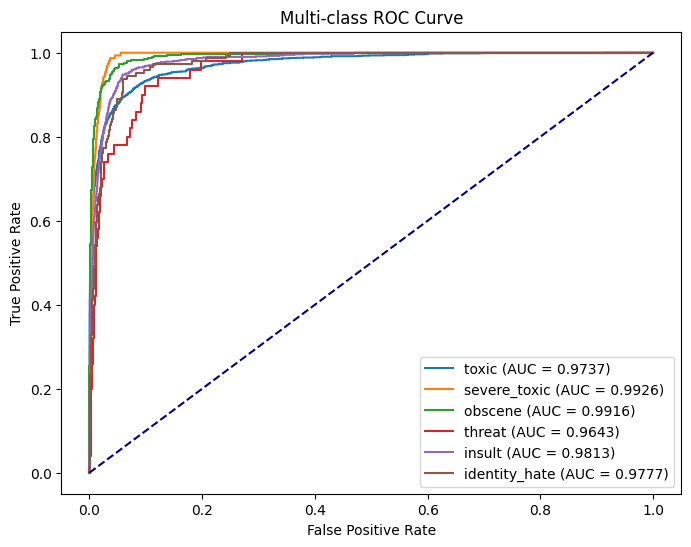

In [59]:
# Required Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras.layers import Dense, Input, LSTM, Embedding, Dropout, GlobalMaxPool1D
from keras.models import Model
from keras import metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, roc_auc_score, roc_curve, confusion_matrix, accuracy_score
import seaborn as sns

# Stopwords and stemmer
stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()

# Define the cleaning function
def clean(comment):
    comment = comment.lower()
    comment = re.sub('[^a-zA-Z]', ' ', comment)  # Remove non-letter characters
    comment = comment.strip().split()
    comment = [stemmer.stem(word) for word in comment if word not in stop_words and len(word) < 30]
    return ' '.join(comment)

# Path to the dataset
path = "/Users/gauravnathani/Desktop/NU Fall Semester 1/Machine Learning Project/"

# Load the data
train = pd.read_csv(path + "train.csv")
test = pd.read_csv(path + "test.csv")
labels = pd.read_csv(path + "test_labels.csv")

# Apply the clean function to preprocess comments
train['cleaned_comment'] = train['comment_text'].apply(clean)
test['cleaned_comment'] = test['comment_text'].apply(clean)

# Define target classes
classes = ["toxic", "severe_toxic", "obscene", "threat", "insult", "identity_hate"]
y = train[classes].values
list_sentences_train = train["cleaned_comment"]
list_sentences_test = test["cleaned_comment"]

# Tokenization
max_features = 20000
tokenizer = Tokenizer(num_words=max_features)
tokenizer.fit_on_texts(list_sentences_train)
list_tokenized_train = tokenizer.texts_to_sequences(list_sentences_train)
list_tokenized_test = tokenizer.texts_to_sequences(list_sentences_test)

# Padding
maxlen = 200
X_t = pad_sequences(list_tokenized_train, maxlen=maxlen)
X_te = pad_sequences(list_tokenized_test, maxlen=maxlen)

# LSTM Model
inp = Input(shape=(maxlen,))
embed_size = 128
x = Embedding(max_features, embed_size)(inp)
x = LSTM(60, return_sequences=True, name='lstm_layer')(x)
x = GlobalMaxPool1D()(x)
x = Dropout(0.1)(x)
x = Dense(50, activation="relu")(x)
x = Dropout(0.1)(x)
x = Dense(6, activation="sigmoid")(x)

# Compile Model
model = Model(inputs=inp, outputs=x)
model.compile(
    loss='binary_crossentropy',
    optimizer='adam',
    metrics=[
        metrics.MeanSquaredError(),
        metrics.AUC(),
    ]
)

# Train-Validation Split
X_train, X_val, y_train, y_val = train_test_split(X_t, y, test_size=0.1, random_state=1)

# Training the Model
batch_size = 32
epochs = 2
model.fit(X_train, y_train, batch_size=batch_size, epochs=epochs)

# Predictions
preds_train = model.predict(X_train)
preds_val = model.predict(X_val)

# Classification Report for Validation Set
print("\nClassification Report (Validation Set):")
print(classification_report(y_val, preds_val > 0.5, target_names=classes))

# Train and Validation ROC-AUC Score
train_auc = roc_auc_score(y_train, preds_train, average='macro')
val_auc = roc_auc_score(y_val, preds_val, average='macro')
print(f"\nTrain ROC-AUC Score: {train_auc:.4f}")
print(f"Validation ROC-AUC Score: {val_auc:.4f}")

# Overall Accuracy Calculation
train_accuracy = accuracy_score(y_train, preds_train > 0.5)
val_accuracy = accuracy_score(y_val, preds_val > 0.5)

# Print Overall Train and Validation Accuracy
print(f"\nOverall Train Accuracy: {train_accuracy:.4f}")
print(f"Overall Validation Accuracy: {val_accuracy:.4f}")

# Multi-class ROC Curve
plt.figure(figsize=(8, 6))

# Plot ROC-AUC curve for each class (multi-class)
for i, class_name in enumerate(classes):
    fpr_train, tpr_train, _ = roc_curve(y_val[:, i], preds_val[:, i])
    auc_score = roc_auc_score(y_val[:, i], preds_val[:, i])
    plt.plot(fpr_train, tpr_train, label=f"{class_name} (AUC = {auc_score:.4f})")

# Diagonal line for random classifier
plt.plot([0, 1], [0, 1], color="navy", linestyle="--")

plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Multi-class ROC Curve")
plt.legend(loc="lower right")
plt.show()

## Bi-LSTM with Glove Embedding

Epoch 1/2


/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/embedding.py:90: UserWarning:

Argument `input_length` is deprecated. Just remove it.



4488/4488 ━━━━━━━━━━━━━━━━━━━━ 333s 74ms/step - auc_15: 0.9271 - loss: 0.0888 - mean_squared_error: 0.0236
Epoch 2/2
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 338s 75ms/step - auc_15: 0.9756 - loss: 0.0544 - mean_squared_error: 0.0148
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 110s 25ms/step
499/499 ━━━━━━━━━━━━━━━━━━━━ 12s 25ms/step

Classification Report (Validation Set):
               precision    recall  f1-score   support

        toxic       0.81      0.72      0.76      1568
 severe_toxic       0.62      0.20      0.30       155
      obscene       0.79      0.80      0.79       872
       threat       0.00      0.00      0.00        50
       insult       0.67      0.69      0.68       804
identity_hate       0.64      0.40      0.49       146

    micro avg       0.76      0.69      0.72      3595
    macro avg       0.59      0.47      0.51      3595
 weighted avg       0.75      0.69      0.71      3595
  samples avg       0.06      0.06      0.06      3595


Train ROC-AUC Score: 0.9809
Validatio

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in samples with no true labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 in samples with no true nor predicted la

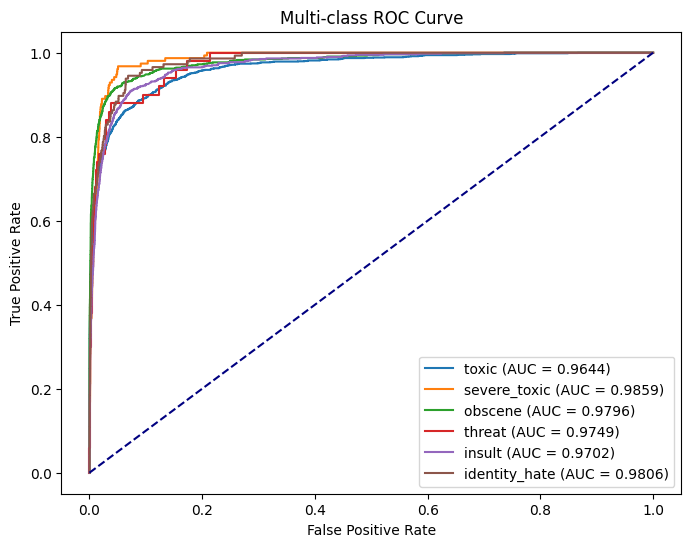

In [60]:
# Required Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras.layers import Dense, Input, LSTM, Embedding, Dropout, GlobalMaxPool1D, Bidirectional
from keras.models import Model
from keras import metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, roc_auc_score, roc_curve, accuracy_score
import seaborn as sns
import os

# Stopwords and stemmer
stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()

# Define the cleaning function
def clean(comment):
    comment = comment.lower()
    comment = re.sub('[^a-zA-Z]', ' ', comment)  # Remove non-letter characters
    comment = comment.strip().split()
    comment = [stemmer.stem(word) for word in comment if word not in stop_words and len(word) < 30]
    return ' '.join(comment)

# Path to the dataset
path = "/Users/gauravnathani/Desktop/NU Fall Semester 1/Machine Learning Project/"

# Load the data
train = pd.read_csv(path + "train.csv")
test = pd.read_csv(path + "test.csv")
labels = pd.read_csv(path + "test_labels.csv")

# Apply the clean function to preprocess comments
train['cleaned_comment'] = train['comment_text'].apply(clean)
test['cleaned_comment'] = test['comment_text'].apply(clean)

# Define target classes
classes = ["toxic", "severe_toxic", "obscene", "threat", "insult", "identity_hate"]
y = train[classes].values
list_sentences_train = train["cleaned_comment"]
list_sentences_test = test["cleaned_comment"]

# Tokenization
max_features = 20000  # Maximum number of unique words
tokenizer = Tokenizer(num_words=max_features)
tokenizer.fit_on_texts(list_sentences_train)
list_tokenized_train = tokenizer.texts_to_sequences(list_sentences_train)
list_tokenized_test = tokenizer.texts_to_sequences(list_sentences_test)

# Padding
maxlen = 200  # Maximum sequence length
X_t = pad_sequences(list_tokenized_train, maxlen=maxlen)
X_te = pad_sequences(list_tokenized_test, maxlen=maxlen)

# Load GloVe Embeddings
embedding_dim = 100  # GloVe vector size
glove_path = "/Users/gauravnathani/Downloads/glove.6B.100d.txt"  # Update with the path to your GloVe file

# Create a dictionary of word to GloVe embedding
embeddings_index = {}
with open(glove_path, "r", encoding="utf-8") as f:
    for line in f:
        values = line.split()
        word = values[0]
        coeffs = np.asarray(values[1:], dtype="float32")
        embeddings_index[word] = coeffs

# Create Embedding Matrix
word_index = tokenizer.word_index
num_words = min(max_features, len(word_index) + 1)
embedding_matrix = np.zeros((num_words, embedding_dim))

for word, i in word_index.items():
    if i < max_features:
        embedding_vector = embeddings_index.get(word)
        if embedding_vector is not None:
            embedding_matrix[i] = embedding_vector

# BiLSTM Model with GloVe Embedding
inp = Input(shape=(maxlen,))
x = Embedding(
    input_dim=num_words, 
    output_dim=embedding_dim, 
    weights=[embedding_matrix], 
    input_length=maxlen, 
    trainable=False  # Set to False to keep GloVe embeddings fixed
)(inp)
x = Bidirectional(LSTM(60, return_sequences=True, name="bilstm_layer"))(x)
x = GlobalMaxPool1D()(x)
x = Dropout(0.1)(x)
x = Dense(50, activation="relu")(x)
x = Dropout(0.1)(x)
x = Dense(6, activation="sigmoid")(x)

# Compile Model
model = Model(inputs=inp, outputs=x)
model.compile(
    loss="binary_crossentropy",
    optimizer="adam",
    metrics=[
        metrics.MeanSquaredError(),
        metrics.AUC(),
    ]
)

# Train-Validation Split
X_train, X_val, y_train, y_val = train_test_split(X_t, y, test_size=0.1, random_state=1)

# Training the Model
batch_size = 32
epochs = 2
model.fit(X_train, y_train, batch_size=batch_size, epochs=epochs)

# Predictions
preds_train = model.predict(X_train)
preds_val = model.predict(X_val)

# Classification Report for Validation Set
print("\nClassification Report (Validation Set):")
print(classification_report(y_val, preds_val > 0.5, target_names=classes))

# Train and Validation ROC-AUC Score
train_auc = roc_auc_score(y_train, preds_train, average="macro")
val_auc = roc_auc_score(y_val, preds_val, average="macro")
print(f"\nTrain ROC-AUC Score: {train_auc:.4f}")
print(f"Validation ROC-AUC Score: {val_auc:.4f}")

# Overall Accuracy Calculation
train_accuracy = accuracy_score(y_train, preds_train > 0.5)
val_accuracy = accuracy_score(y_val, preds_val > 0.5)

# Print Overall Train and Validation Accuracy
print(f"\nOverall Train Accuracy: {train_accuracy:.4f}")
print(f"Overall Validation Accuracy: {val_accuracy:.4f}")

# Multi-class ROC Curve
plt.figure(figsize=(8, 6))

# Plot ROC-AUC curve for each class (multi-class)
for i, class_name in enumerate(classes):
    fpr_train, tpr_train, _ = roc_curve(y_val[:, i], preds_val[:, i])
    auc_score = roc_auc_score(y_val[:, i], preds_val[:, i])
    plt.plot(fpr_train, tpr_train, label=f"{class_name} (AUC = {auc_score:.4f})")

# Diagonal line for random classifier
plt.plot([0, 1], [0, 1], color="navy", linestyle="--")

plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Multi-class ROC Curve")
plt.legend(loc="lower right")
plt.show()

## CNN + LSTM Model

Epoch 1/2
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 140s 31ms/step - auc_18: 0.9135 - loss: 0.0931 - mean_squared_error: 0.0249
Epoch 2/2
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 148s 33ms/step - auc_18: 0.9828 - loss: 0.0465 - mean_squared_error: 0.0131
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 39s 9ms/step
499/499 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step

CNN + LSTM - Classification Report (Validation Set):
               precision    recall  f1-score   support

        toxic       0.90      0.67      0.77      1568
 severe_toxic       0.50      0.05      0.08       155
      obscene       0.90      0.65      0.76       872
       threat       0.00      0.00      0.00        50
       insult       0.77      0.51      0.61       804
identity_hate       0.00      0.00      0.00       146

    micro avg       0.87      0.57      0.69      3595
    macro avg       0.51      0.31      0.37      3595
 weighted avg       0.80      0.57      0.66      3595
  samples avg       0.06      0.05      0.05      3595


Train ROC-AUC Scor

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in samples with no true labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 in samples with no true nor predicted la

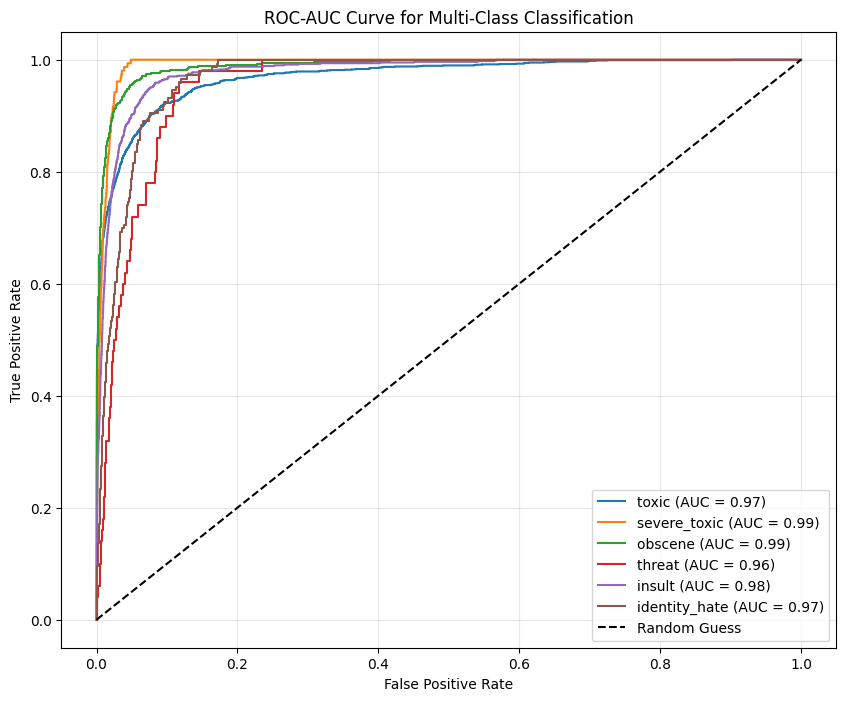

In [66]:
# CNN + LSTM Model
from keras.layers import Conv1D, MaxPooling1D
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import re
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

# Stopwords and stemmer
stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()

# Define the cleaning function
def clean(comment):
    comment = comment.lower()
    comment = re.sub('[^a-zA-Z]', ' ', comment)  # Remove non-letter characters
    comment = comment.strip().split()
    comment = [stemmer.stem(word) for word in comment if word not in stop_words and len(word) < 30]
    return ' '.join(comment)

# Path to the dataset
path = "/Users/gauravnathani/Desktop/NU Fall Semester 1/Machine Learning Project/"

# Load the data
train = pd.read_csv(path + "train.csv")
test = pd.read_csv(path + "test.csv")
labels = pd.read_csv(path + "test_labels.csv")

# Apply the clean function to preprocess comments
train['cleaned_comment'] = train['comment_text'].apply(clean)
test['cleaned_comment'] = test['comment_text'].apply(clean)

# Define target classes
classes = ["toxic", "severe_toxic", "obscene", "threat", "insult", "identity_hate"]
y = train[classes].values
list_sentences_train = train["cleaned_comment"]
list_sentences_test = test["cleaned_comment"]

# Tokenization
max_features = 20000  # Maximum number of unique words
tokenizer = Tokenizer(num_words=max_features)
tokenizer.fit_on_texts(list_sentences_train)
list_tokenized_train = tokenizer.texts_to_sequences(list_sentences_train)
list_tokenized_test = tokenizer.texts_to_sequences(list_sentences_test)

# Padding
maxlen = 200  # Maximum sequence length
X_t = pad_sequences(list_tokenized_train, maxlen=maxlen)
X_te = pad_sequences(list_tokenized_test, maxlen=maxlen)

# CNN + LSTM Model
from keras.layers import Dense, Input, Embedding, Dropout, GlobalMaxPool1D, LSTM

# CNN + LSTM Model
inp = Input(shape=(maxlen,))
embed_size = 128
x = Embedding(max_features, embed_size)(inp)

# Convolutional Layer
x = Conv1D(128, 5, activation='relu')(x)  # 128 filters, kernel size 5
x = MaxPooling1D(pool_size=4)(x)  # Max pooling layer

# LSTM Layer
x = LSTM(60, return_sequences=True)(x)  # LSTM layer
x = GlobalMaxPool1D()(x)
x = Dropout(0.1)(x)

# Dense Layers
x = Dense(50, activation="relu")(x)
x = Dropout(0.1)(x)
x = Dense(6, activation="sigmoid")(x)

# Compile Model
cnn_lstm_model = Model(inputs=inp, outputs=x)
cnn_lstm_model.compile(
    loss='binary_crossentropy',
    optimizer='adam',
    metrics=[
        metrics.MeanSquaredError(),
        metrics.AUC(),
    ]
)

# Train-Validation Split
X_train, X_val, y_train, y_val = train_test_split(X_t, y, test_size=0.1, random_state=1)

# Training the Model
batch_size = 32
epochs = 2
cnn_lstm_model.fit(X_train, y_train, batch_size=batch_size, epochs=epochs)

# Predictions
cnn_preds_train = cnn_lstm_model.predict(X_train)
cnn_preds_val = cnn_lstm_model.predict(X_val)

# Classification Report for Validation Set
print("\nCNN + LSTM - Classification Report (Validation Set):")
print(classification_report(y_val, cnn_preds_val > 0.5, target_names=classes))

# Train and Validation ROC-AUC Score
train_auc = roc_auc_score(y_train, cnn_preds_train, average='macro', multi_class='ovr')
val_auc = roc_auc_score(y_val, cnn_preds_val, average='macro', multi_class='ovr')
print(f"\nTrain ROC-AUC Score: {train_auc:.4f}")
print(f"Validation ROC-AUC Score: {val_auc:.4f}")

# Overall Accuracy Calculation
cnn_train_accuracy = accuracy_score(y_train, cnn_preds_train > 0.5)
cnn_val_accuracy = accuracy_score(y_val, cnn_preds_val > 0.5)

# Print Overall Train and Validation Accuracy
print(f"\nCNN + LSTM - Overall Train Accuracy: {cnn_train_accuracy:.4f}")
print(f"CNN + LSTM - Overall Validation Accuracy: {cnn_val_accuracy:.4f}")

# Plot ROC Curve for Multi-Class Classification
plt.figure(figsize=(10, 8))

# Generate ROC-AUC curves for each class
for i, class_name in enumerate(classes):
    fpr, tpr, _ = roc_curve(y_val[:, i], cnn_preds_val[:, i])
    auc_score = roc_auc_score(y_val[:, i], cnn_preds_val[:, i])
    plt.plot(fpr, tpr, label=f"{class_name} (AUC = {auc_score:.2f})")

# Plot the random guess line
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")

# Customize the plot
plt.title("ROC-AUC Curve for Multi-Class Classification")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.grid(alpha=0.3)
plt.show()

## CNN + LSTM with Glove Embedding

Epoch 1/2


/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/embedding.py:90: UserWarning:

Argument `input_length` is deprecated. Just remove it.



4488/4488 ━━━━━━━━━━━━━━━━━━━━ 97s 21ms/step - accuracy: 0.8598 - loss: 0.0980 - val_accuracy: 0.9939 - val_loss: 0.0627
Epoch 2/2
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 100s 22ms/step - accuracy: 0.9903 - loss: 0.0582 - val_accuracy: 0.9939 - val_loss: 0.0588
4488/4488 ━━━━━━━━━━━━━━━━━━━━ 32s 7ms/step
499/499 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step

CNN + LSTM - Classification Report (Validation Set):
               precision    recall  f1-score   support

        toxic       0.88      0.61      0.72      1568
 severe_toxic       0.71      0.03      0.06       155
      obscene       0.88      0.65      0.75       872
       threat       0.00      0.00      0.00        50
       insult       0.74      0.53      0.62       804
identity_hate       0.00      0.00      0.00       146

    micro avg       0.84      0.54      0.66      3595
    macro avg       0.53      0.30      0.36      3595
 weighted avg       0.79      0.54      0.64      3595
  samples avg       0.06      0.05      0.05      3595



/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in samples with no true labels. Use `zero_division` parameter to control this behavior.

/Users/gauravnathani/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 in samples with no true nor predicted la

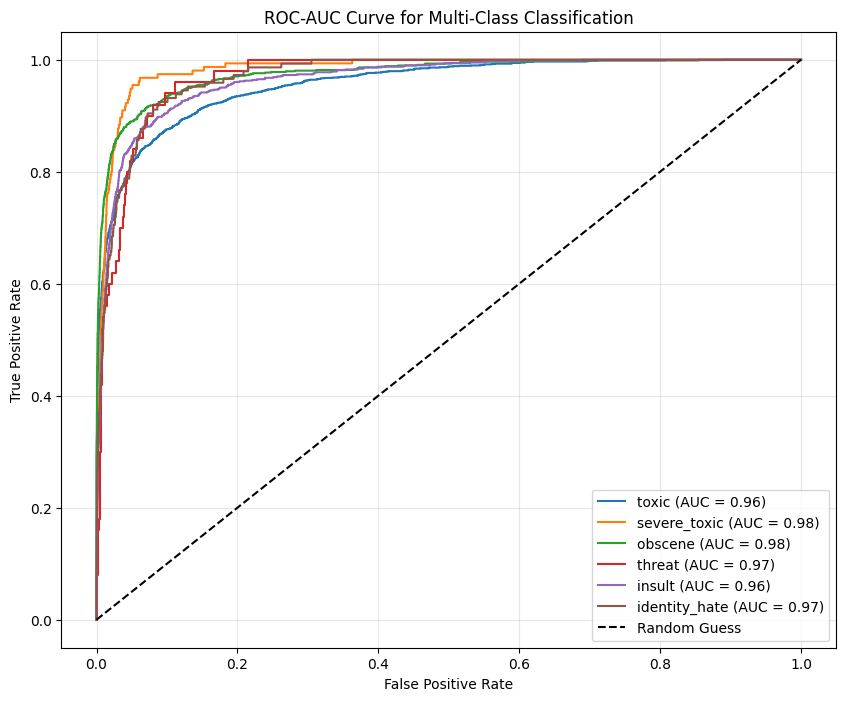

In [65]:
import numpy as np
import pandas as pd
import re
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, roc_auc_score, roc_curve
import matplotlib.pyplot as plt
from keras.layers import Conv1D, MaxPooling1D, Dense, Input, Embedding, Dropout, GlobalMaxPool1D, LSTM
from keras.models import Model
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

# Preprocessing setup
stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()

# Define the cleaning function
def clean(comment):
    comment = comment.lower()
    comment = re.sub('[^a-zA-Z]', ' ', comment)  # Remove non-letter characters
    comment = comment.strip().split()
    comment = [stemmer.stem(word) for word in comment if word not in stop_words and len(word) < 30]
    return ' '.join(comment)

# Load the data
path = "/Users/gauravnathani/Desktop/NU Fall Semester 1/Machine Learning Project/"
train = pd.read_csv(path + "train.csv")
test = pd.read_csv(path + "test.csv")
labels = pd.read_csv(path + "test_labels.csv")

# Apply the clean function to preprocess comments
train['cleaned_comment'] = train['comment_text'].apply(clean)
test['cleaned_comment'] = test['comment_text'].apply(clean)

# Define target classes
classes = ["toxic", "severe_toxic", "obscene", "threat", "insult", "identity_hate"]
y = train[classes].values
list_sentences_train = train["cleaned_comment"]
list_sentences_test = test["cleaned_comment"]

# Tokenization
max_features = 20000  # Maximum number of unique words
tokenizer = Tokenizer(num_words=max_features)
tokenizer.fit_on_texts(list_sentences_train)
list_tokenized_train = tokenizer.texts_to_sequences(list_sentences_train)
list_tokenized_test = tokenizer.texts_to_sequences(list_sentences_test)

# Padding
maxlen = 200  # Maximum sequence length
X_t = pad_sequences(list_tokenized_train, maxlen=maxlen)
X_te = pad_sequences(list_tokenized_test, maxlen=maxlen)

# Load GloVe embeddings
def load_glove_embeddings(glove_file_path, embed_size):
    embeddings_index = {}
    with open(glove_file_path, 'r', encoding='utf-8') as f:
        for line in f:
            values = line.split()
            word = values[0]
            coefs = np.asarray(values[1:], dtype='float32')
            embeddings_index[word] = coefs
    return embeddings_index

# Create the embedding matrix
def create_embedding_matrix(word_index, embeddings_index, embed_size):
    embedding_matrix = np.zeros((len(word_index) + 1, embed_size))
    for word, i in word_index.items():
        embedding_vector = embeddings_index.get(word)
        if embedding_vector is not None:  # Words not found in embedding index will be zeros.
            embedding_matrix[i] = embedding_vector
    return embedding_matrix

# Load GloVe embeddings
glove_file_path = "/Users/gauravnathani/Downloads/glove.6B.100d.txt"  # Adjust path and dimension as necessary
embed_size = 100
embeddings_index = load_glove_embeddings(glove_file_path, embed_size)

# Create the embedding matrix using the tokenizer's word index
word_index = tokenizer.word_index
embedding_matrix = create_embedding_matrix(word_index, embeddings_index, embed_size)

# CNN + LSTM Model
inp = Input(shape=(maxlen,))
x = Embedding(
    input_dim=len(word_index) + 1,  # Size of vocabulary
    output_dim=embed_size,  # GloVe embedding size
    weights=[embedding_matrix],  # Pre-trained embeddings
    input_length=maxlen,
    trainable=False  # Freeze GloVe embeddings
)(inp)

# Convolutional Layer
x = Conv1D(128, 5, activation='relu')(x)  # 128 filters, kernel size 5
x = MaxPooling1D(pool_size=4)(x)  # Max pooling layer

# LSTM Layer
x = LSTM(60, return_sequences=True)(x)  # LSTM layer
x = GlobalMaxPool1D()(x)
x = Dropout(0.1)(x)

# Dense Layers
x = Dense(50, activation="relu")(x)
x = Dropout(0.1)(x)
x = Dense(6, activation="sigmoid")(x)

# Compile Model
cnn_lstm_model = Model(inputs=inp, outputs=x)
cnn_lstm_model.compile(
    loss='binary_crossentropy',
    optimizer='adam',
    metrics=['accuracy']
)

# Train-Validation Split
X_train, X_val, y_train, y_val = train_test_split(X_t, y, test_size=0.1, random_state=1)

# Training the Model
batch_size = 32
epochs = 2
history = cnn_lstm_model.fit(X_train, y_train, batch_size=batch_size, epochs=epochs, validation_data=(X_val, y_val))

# Predictions
cnn_preds_train = cnn_lstm_model.predict(X_train)  # Predictions on training data
cnn_preds_val = cnn_lstm_model.predict(X_val)     # Predictions on validation data

# Compute overall binary accuracy for train and validation sets
def compute_overall_accuracy(y_true, y_pred, threshold=0.5):
    # Convert probabilities to binary predictions
    y_pred_binary = (y_pred > threshold).astype(int)
    # Compute overall accuracy
    accuracy = np.mean(np.all(y_pred_binary == y_true, axis=1))
    return accuracy



# Classification Report for Validation Set
print("\nCNN + LSTM - Classification Report (Validation Set):")
print(classification_report(y_val, cnn_preds_val > 0.5, target_names=classes))


# Train and Validation ROC-AUC Score
train_auc = roc_auc_score(y_train, cnn_preds_train, average='macro', multi_class='ovr')
val_auc = roc_auc_score(y_val, cnn_preds_val, average='macro', multi_class='ovr')
print(f"\nTrain ROC-AUC Score: {train_auc:.4f}")
print(f"Validation ROC-AUC Score: {val_auc:.4f}")


# Calculate train and validation accuracies
train_accuracy = compute_overall_accuracy(y_train, cnn_preds_train)
val_accuracy = compute_overall_accuracy(y_val, cnn_preds_val)

print(f"Overall Training Accuracy: {train_accuracy:.4f}")
print(f"Overall Validation Accuracy: {val_accuracy:.4f}")

# ROC-AUC Curve for Multi-Class Classification
plt.figure(figsize=(10, 8))

# Generate ROC-AUC curves for each class
for i, class_name in enumerate(classes):
    fpr, tpr, _ = roc_curve(y_val[:, i], cnn_preds_val[:, i])
    auc_score = roc_auc_score(y_val[:, i], cnn_preds_val[:, i])
    plt.plot(fpr, tpr, label=f"{class_name} (AUC = {auc_score:.2f})")

# Plot the random guess line
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")

# Customize the plot
plt.title("ROC-AUC Curve for Multi-Class Classification")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.grid(alpha=0.3)
plt.show()


## Model Comparison

| **Model**                | **ROC-AUC (Train)** | **ROC-AUC (Val)** | **Accuracy (Train)** | **Accuracy (Val)** |
|--------------------------|---------------------|-------------------|----------------------|--------------------|
| **LSTM**                 | **0.9883**          | **0.9807**        | **0.9293**           | **0.9183**         |
| LSTM + GloVe             | 0.9771              | 0.9741            | 0.9201               | 0.9162             |
| Bi-LSTM                  | 0.9877              | 0.9802            | 0.9294               | 0.9174             |
| Bi-LSTM + GloVe          | 0.9809              | 0.9759            | 0.9194               | 0.9130             |
| CNN + LSTM               | 0.9851              | 0.9774            | 0.9314               | 0.9183             |
| CNN + LSTM + GloVe       | 0.9809              | 0.9759            | 0.9177               | 0.9084             |



## Conclusion:
Based on the comparison, the LSTM model is the best choice due to
its balanced precision and recall, slightly higher ROC-AUC (0.9807),
and robust validation accuracy (0.9183). These metrics make it the
most effective model for identifying toxic content across all classes